In [2]:
# possible v3
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import medfilt
import librosa
import IPython.display as ipdimport numpy as np
import matplotlib.pyplot as plt
from scipy.signal import medfilt
import librosa
import IPython.display as ipd
import soundfile as sf
from sklearn.cluster import KMeans

audio_path = "/home/acacia/下载/ARForest - The Last Page.flac"
file2beats = File2Beats(checkpoint_path="final0", dbn=False)
origin_beats, _ = file2beats(audio_path)

# 1. 剔除异常节拍点
beats = np.array(origin_beats)
intervals = np.diff(beats)

# 设置合理的间隔范围（秒）
min_interval = 0.15  # 最小间隔
max_interval = 1.0   # 最大间隔

valid_indices = np.where((intervals >= min_interval) & (intervals <= max_interval))[0]
filtered_beats = np.array([beats[0]] + [beats[i+1] for i in valid_indices])
filtered_intervals = np.diff(filtered_beats)

# 2. 计算原始 BPM
raw_bpms = 60 / filtered_intervals

# 3. 识别真正的基准BPM
# 创建BPM直方图
plt.figure(figsize=(12, 4))
hist, bins = np.histogram(raw_bpms, bins=100, range=(60, 600))
bin_centers = 0.5 * (bins[1:] + bins[:-1])
plt.bar(bin_centers, hist, width=bins[1]-bins[0])
plt.title("BPM 分布直方图")
plt.xlabel("BPM")
plt.ylabel("频率")
plt.grid(True)
plt.show()

# 使用聚类找出主要BPM组
# 限制聚类数为5，涵盖可能的1x, 2x, 3x, 4x倍速
n_clusters = min(5, len(raw_bpms))
km = KMeans(n_clusters=n_clusters, random_state=0).fit(raw_bpms.reshape(-1, 1))
centers = sorted(km.cluster_centers_.flatten())

print("检测到的BPM聚类中心:", [round(c) for c in centers])

# 寻找可能的基准BPM（查找成倍数关系）
ratios = []
for i in range(len(centers)):
    for j in range(i+1, len(centers)):
        ratio = centers[j] / centers[i]
        ratios.append((ratio, centers[i], centers[j]))

# 筛选接近整数倍的比例
integer_ratios = [(r, base, higher) for r, base, higher in ratios
                  if abs(round(r) - r) < 0.15 and round(r) > 1]

if integer_ratios:
    # 按基准BPM从小到大排序
    integer_ratios.sort(key=lambda x: x[1])
    base_bpm = integer_ratios[0][1]
    print(f"推测基准BPM为: {round(base_bpm)}")
else:
    # 如果没找到明显的倍数关系，使用最小的聚类中心
    base_bpm = centers[0]
    print(f"未检测到明显倍数关系，使用最小值作为基准BPM: {round(base_bpm)}")

# 4. 将所有BPM归一化到基准
normalized_bpms = np.copy(raw_bpms)
for i in range(len(normalized_bpms)):
    ratio = normalized_bpms[i] / base_bpm
    if ratio > 1.3:  # 如果是基准的1.3倍以上
        # 找到最接近的整数倍
        multiple = round(ratio)
        if multiple > 1 and abs(ratio - multiple) < 0.2:
            normalized_bpms[i] = normalized_bpms[i] / multiple

# 5. 平滑处理
kernel_size = 11  # 必须是奇数
smoothed_bpms = medfilt(normalized_bpms, kernel_size)

# 6. 识别稳定BPM段落
stable_bpms = []
stable_start_times = []
stable_end_times = []
stable_durations = []

tolerance = 4.0  # BPM差异容差
min_duration = 1.0  # 最小持续时间

current_bpm = smoothed_bpms[0]
segment_start_idx = 0
time_points = filtered_beats[:-1]

for i in range(1, len(smoothed_bpms)):
    if abs(smoothed_bpms[i] - current_bpm) > tolerance:
        duration = time_points[i-1] - time_points[segment_start_idx]
        if duration >= min_duration:
from beat_this.inference import File2Beats

import soundfile as sf
from scipy.stats import mode

audio_path = "/home/acacia/下载/ARForest - The Last Page.flac"
file2beats = File2Beats(checkpoint_path="final0", dbn=False)
origin_beats, _ = file2beats(audio_path)


# 1. 剔除异常节拍点
beats = np.array(origin_beats)
intervals = np.diff(beats)

# 设置合理的间隔范围（秒）
min_interval = 0.15  # 最小间隔
max_interval = 1.0  # 最大间隔

# 找出合理区间的索引
valid_indices = np.where((intervals >= min_interval) & (intervals <= max_interval))[0]

# 更新节拍时间点和间隔
filtered_beats = np.array([beats[0]] + [beats[i+1] for i in valid_indices])
filtered_intervals = np.diff(filtered_beats)

# 2. 计算原始 BPM
raw_bpms = 60 / filtered_intervals

# 3. 确定基准BPM
# 统计BPM分布，分为两组：<150和>150
low_bpms = raw_bpms[raw_bpms < 150]
high_bpms = raw_bpms[raw_bpms >= 150]

# 计算两组BPM的总持续时间
low_bpm_duration = sum(filtered_intervals[raw_bpms < 150])
high_bpm_duration = sum(filtered_intervals[raw_bpms >= 150])

# 判断应该使用哪个基准
use_high_base = False

# 统一归一化所有BPM到同一基准
normalized_bpms = np.copy(raw_bpms)
if use_high_base:
    print(f"统一使用高BPM基准（约200）")
    # 将所有低于240的BPM乘以2
    normalized_bpms = np.where(normalized_bpms < 260, normalized_bpms * 2, normalized_bpms)
else:
    print(f"统一使用低BPM基准（约100）")
    # 将所有高于240的BPM除以2
    normalized_bpms = np.where(normalized_bpms >= 260, normalized_bpms / 2, normalized_bpms)

# 4. 使用中值滤波平滑 BPM
kernel_size = 11  # 必须是奇数
smoothed_bpms = medfilt(normalized_bpms, kernel_size)

# 5. 聚类相近的 BPM 找到稳定段落
stable_bpms = []
stable_start_times = []
stable_end_times = []
stable_durations = []

# BPM 聚类容差
tolerance = 4.0  # BPM差异3以内被视为同一段
min_duration = 1.0  # 最小持续2秒才视为稳定段落

current_bpm = smoothed_bpms[0]
segment_start_idx = 0
time_points = filtered_beats[:-1]  # BPM 对应的时间点

for i in range(1, len(smoothed_bpms)):
    if abs(smoothed_bpms[i] - current_bpm) > tolerance:
        # 计算当前段落的持续时间
        duration = time_points[i-1] - time_points[segment_start_idx]
        if duration >= min_duration:
            stable_bpms.append(round(current_bpm))
            stable_start_times.append(time_points[segment_start_idx])
            stable_end_times.append(time_points[i-1])
            stable_durations.append(duration)

        # 更新为新段落
        current_bpm = smoothed_bpms[i]
        segment_start_idx = i

# 处理最后一个段落
duration = time_points[-1] - time_points[segment_start_idx]
if duration >= min_duration:
    stable_bpms.append(round(current_bpm))
    stable_start_times.append(time_points[segment_start_idx])
    stable_end_times.append(time_points[-1])
    stable_durations.append(duration)

# 6. 调整原始节拍时间点
corrected_beats = []
for beat in origin_beats:
    # 检查这个节拍点是否在某个稳定段落内
    in_stable_segment = False
    expected_interval = None

    for i in range(len(stable_bpms)):
        if stable_start_times[i] <= beat <= stable_end_times[i]:
            in_stable_segment = True
            expected_interval = 60 / stable_bpms[i]
            break

    if in_stable_segment:
        # 检查与最近的正确节拍的间隔是否合理
        if len(corrected_beats) > 0:
            last_beat = corrected_beats[-1]
            interval = beat - last_beat

            # 检查是否有缺失的节拍点
            if interval > 1.5 * expected_interval:
                # 计算需要添加多少个节拍点
                num_missing = round(interval / expected_interval) - 1
                if num_missing > 0:
                    for i in range(1, num_missing + 1):
                        # 在适当位置添加缺失的节拍点
                        missing_beat = last_beat + i * expected_interval
                        corrected_beats.append(missing_beat)
                    # 排序以保持时间顺序
                    corrected_beats.sort()
                    # 更新最后一个正确节拍点
                    last_beat = corrected_beats[-1]
                    # 重新计算间隔
                    interval = beat - last_beat

            # 如果间隔接近预期的节拍间隔或其倍数，则保留
            if ((abs(interval % expected_interval) < 0.1 * expected_interval) or
                (abs(interval % expected_interval - expected_interval) < 0.1 * expected_interval)):
                corrected_beats.append(beat)
            # 否则尝试调整到最近的正确位置
            else:
                # 计算期望的下一个节拍时间
                expected_beat = last_beat + round(interval / expected_interval) * expected_interval
                # 如果差距不大，则调整
                if abs(beat - expected_beat) < 0.2 * expected_interval:
                    corrected_beats.append(expected_beat)
                # 否则认为这是错误节拍，丢弃
        else:
            # 第一个节拍点
            corrected_beats.append(beat)
    else:
        # 在不稳定段落中的节拍，保留原始节拍点
        corrected_beats.append(beat)

# 7. 可视化
plt.figure(figsize=(14, 6))
plt.plot(time_points, raw_bpms, 'r.', alpha=0.3, label='base BPM')
plt.plot(time_points, normalized_bpms, 'g.', alpha=0.3, label='normalized BPM')
plt.plot(time_points, smoothed_bpms, 'b-', linewidth=2, label='smooth BPM')

# 在图上标记稳定的BPM段落
for i in range(len(stable_bpms)):
    plt.axhline(y=stable_bpms[i], xmin=stable_start_times[i]/time_points[-1],
                xmax=stable_end_times[i]/time_points[-1],
                color='g', linestyle='-', linewidth=3, alpha=0.5)
    plt.text(stable_start_times[i]+stable_durations[i]/2, stable_bpms[i]+2,
             f"{stable_bpms[i]} BPM", ha='center')

plt.title(f"BPM as time change")
plt.xlabel("time (s)")
plt.ylabel("BPM")
plt.grid(True)
plt.legend()
plt.show()


# 9. 播放修正后的节拍
audio, sr = sf.read(audio_path)
if len(audio.shape) > 1:
    audio = np.mean(audio, axis=1)

audio_beat = librosa.clicks(times=corrected_beats, sr=sr, click_freq=1000, length=len(audio))
ipd.display(ipd.Audio(audio + audio_beat, rate=sr))

# 打印结果信息
print("\n稳定BPM段落统计:")
print("-------------------------")
print("BPM值 | 开始时间(秒) | 持续时间(秒)")
print("-------------------------")
for i in range(len(stable_bpms)):
    print(f"{stable_bpms[i]:4d} | {stable_start_times[i]:11.1f} | {stable_durations[i]:10.1f}")

print(f"\n原始节拍数量: {len(origin_beats)}")
print(f"修正后节拍数量: {len(corrected_beats)}")

SyntaxError: invalid syntax (3042504918.py, line 6)

/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 39057 (\N{CJK UNIFIED IDEOGRAPH-9891}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 29575 (\N{CJK UNIFIED IDEOGRAPH-7387}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 20998 (\N{CJK UNIFIED IDEOGRAPH-5206}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 24067 (\N{CJK UNIFIED IDEOGRAPH-5E03}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pyl

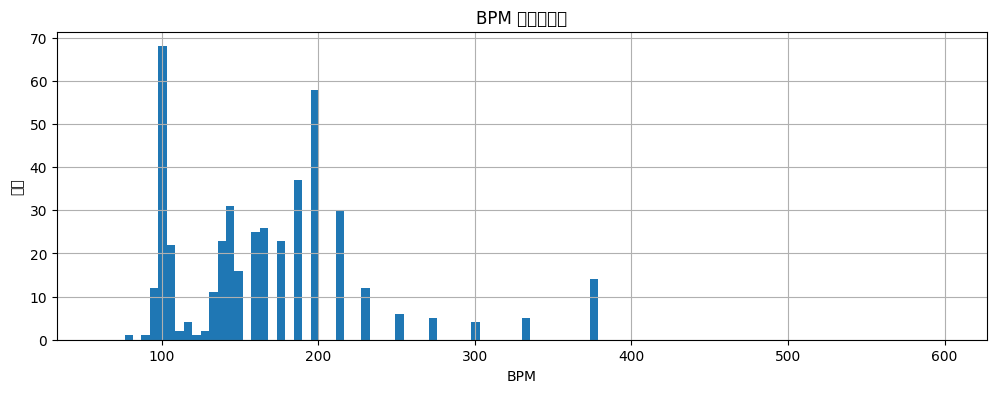

检测到的BPM聚类中心: [101, 149, 196, 245, 353]
推测基准BPM为: 101


/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 38543 (\N{CJK UNIFIED IDEOGRAPH-968F}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 26102 (\N{CJK UNIFIED IDEOGRAPH-65F6}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 38388 (\N{CJK UNIFIED IDEOGRAPH-95F4}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 21464 (\N{CJK UNIFIED IDEOGRAPH-53D8}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pyl

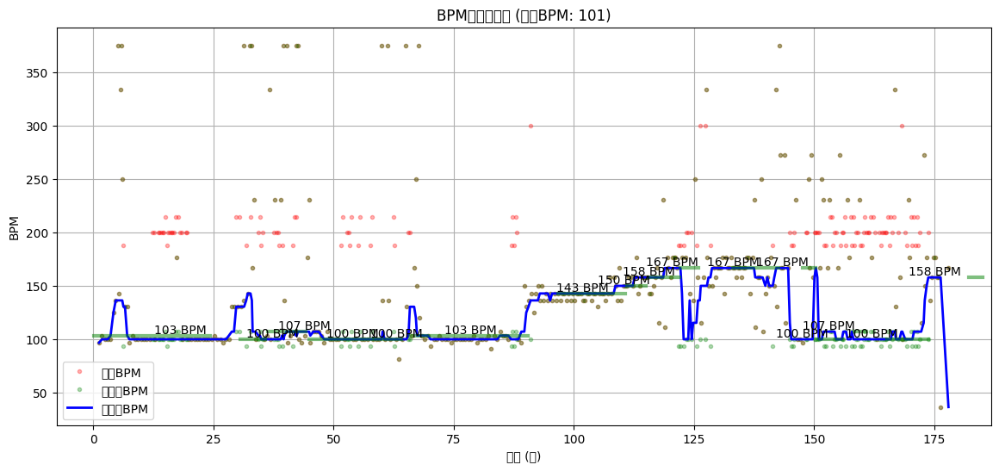

/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 33410 (\N{CJK UNIFIED IDEOGRAPH-8282}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 25293 (\N{CJK UNIFIED IDEOGRAPH-62CD}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 19982 (\N{CJK UNIFIED IDEOGRAPH-4E0E}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 20462 (\N{CJK UNIFIED IDEOGRAPH-4FEE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/home/acacia/.conda/envs/beat_this/lib/python3.10/site-packages/IPython/core/pyl

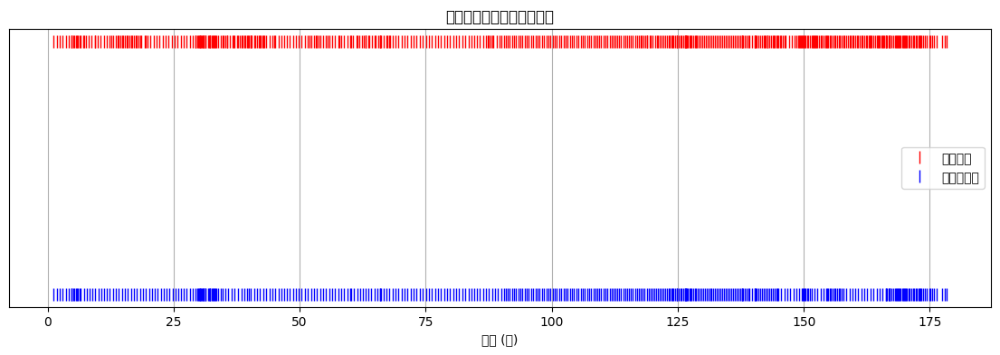


稳定BPM段落统计 (基准BPM: 101):
-------------------------
BPM值 | 开始时间(秒) | 持续时间(秒)
-------------------------
 103 |         7.1 |       22.2
 100 |        35.0 |        4.8
 107 |        40.2 |        7.3
 100 |        48.0 |       12.0
 100 |        60.6 |        5.0
 103 |        67.4 |       22.3
 143 |        95.5 |       12.8
 150 |       108.6 |        3.6
 158 |       112.6 |        5.9
 167 |       118.8 |        3.3
 167 |       128.7 |        8.7
 167 |       142.1 |        2.5
 100 |       145.2 |        4.4
 107 |       151.8 |        2.4
 100 |       158.1 |        7.8
 158 |       173.7 |        2.6

原始节拍数量: 499
修正后节拍数量: 419


In [12]:
#possible v4
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import medfilt
import librosa
import IPython.display as ipd
import soundfile as sf
from sklearn.cluster import KMeans
from beat_this.inference import File2Beats

audio_path = "/home/acacia/下载/名乗る名が無い - Designant. (Game ver.).flac"
file2beats = File2Beats(checkpoint_path="final0", dbn=False)
origin_beats, _ = file2beats(audio_path)

# 1. 剔除异常节拍点
beats = np.array(origin_beats)
intervals = np.diff(beats)

# 设置合理的间隔范围（秒）
min_interval = 0.15  # 最小间隔
max_interval = 1.0   # 最大间隔

valid_indices = np.where((intervals >= min_interval) & (intervals <= max_interval))[0]
filtered_beats = np.array([beats[0]] + [beats[i+1] for i in valid_indices])
filtered_intervals = np.diff(filtered_beats)

# 2. 计算原始 BPM
raw_bpms = 60 / filtered_intervals

# 3. 识别真正的基准BPM
# 创建BPM直方图
plt.figure(figsize=(12, 4))
hist, bins = np.histogram(raw_bpms, bins=100, range=(60, 600))
bin_centers = 0.5 * (bins[1:] + bins[:-1])
plt.bar(bin_centers, hist, width=bins[1]-bins[0])
plt.title("BPM 分布直方图")
plt.xlabel("BPM")
plt.ylabel("频率")
plt.grid(True)
plt.show()

# 使用聚类找出主要BPM组
# 限制聚类数为5，涵盖可能的1x, 2x, 3x, 4x倍速
n_clusters = min(5, len(raw_bpms))
km = KMeans(n_clusters=n_clusters, random_state=0).fit(raw_bpms.reshape(-1, 1))
centers = sorted(km.cluster_centers_.flatten())

print("检测到的BPM聚类中心:", [round(c) for c in centers])

# 寻找可能的基准BPM（查找成倍数关系）
ratios = []
for i in range(len(centers)):
    for j in range(i+1, len(centers)):
        ratio = centers[j] / centers[i]
        ratios.append((ratio, centers[i], centers[j]))

# 筛选接近整数倍的比例
integer_ratios = [(r, base, higher) for r, base, higher in ratios
                  if abs(round(r) - r) < 0.15 and round(r) > 1]

if integer_ratios:
    # 按基准BPM从小到大排序
    integer_ratios.sort(key=lambda x: x[1])
    base_bpm = integer_ratios[0][1]
    print(f"推测基准BPM为: {round(base_bpm)}")
else:
    # 如果没找到明显的倍数关系，使用最小的聚类中心
    base_bpm = centers[0]
    print(f"未检测到明显倍数关系，使用最小值作为基准BPM: {round(base_bpm)}")

# 4. 将所有BPM归一化到基准
normalized_bpms = np.copy(raw_bpms)
for i in range(len(normalized_bpms)):
    ratio = normalized_bpms[i] / base_bpm
    if ratio > 1.3:  # 如果是基准的1.3倍以上
        # 找到最接近的整数倍
        multiple = round(ratio)
        if multiple > 1 and abs(ratio - multiple) < 0.2:
            normalized_bpms[i] = normalized_bpms[i] / multiple

# 5. 平滑处理
kernel_size = 11  # 必须是奇数
smoothed_bpms = medfilt(normalized_bpms, kernel_size)

# 6. 识别稳定BPM段落
stable_bpms = []
stable_start_times = []
stable_end_times = []
stable_durations = []

tolerance = 4.0  # BPM差异容差
min_duration = 2  # 最小持续时间

current_bpm = smoothed_bpms[0]
segment_start_idx = 0
time_points = filtered_beats[:-1]

for i in range(1, len(smoothed_bpms)):
    if abs(smoothed_bpms[i] - current_bpm) > tolerance:
        duration = time_points[i-1] - time_points[segment_start_idx]
        if duration >= min_duration:
            stable_bpms.append(round(current_bpm))
            stable_start_times.append(time_points[segment_start_idx])
            stable_end_times.append(time_points[i-1])
            stable_durations.append(duration)
        current_bpm = smoothed_bpms[i]
        segment_start_idx = i

# 处理最后一个段落
duration = time_points[-1] - time_points[segment_start_idx]
if duration >= min_duration:
    stable_bpms.append(round(current_bpm))
    stable_start_times.append(time_points[segment_start_idx])
    stable_end_times.append(time_points[-1])
    stable_durations.append(duration)

# 7. 调整原始节拍点并处理倍速区域
corrected_beats = []
last_beat_time = -np.inf

for beat in origin_beats:
    # 查找当前节拍所在的稳定BPM段落
    current_segment = -1
    for i in range(len(stable_bpms)):
        if stable_start_times[i] <= beat <= stable_end_times[i]:
            current_segment = i
            break

    if current_segment >= 0:
        segment_bpm = stable_bpms[current_segment]
        expected_interval = 60 / segment_bpm

        # 检查与上一个节拍的时间间隔
        if len(corrected_beats) > 0:
            last_beat = corrected_beats[-1]
            interval = beat - last_beat

            # 如果间隔太小(说明可能是高倍速区域的额外节拍)
            if interval < 0.8 * expected_interval:
                # 跳过这个节拍点(不添加到corrected_beats)
                continue

            # 检查是否缺失节拍
            if interval > 1.5 * expected_interval:
                # 添加缺失的节拍点
                num_missing = round(interval / expected_interval) - 1
                for i in range(1, num_missing + 1):
                    missing_beat = last_beat + i * expected_interval
                    corrected_beats.append(missing_beat)

            # 如果间隔合理或接近预期间隔的整数倍，保留
            if (abs(interval % expected_interval) < 0.2 * expected_interval or
                abs(interval % expected_interval - expected_interval) < 0.2 * expected_interval):
                corrected_beats.append(beat)
            else:
                # 调整到最接近的正确位置
                expected_beat = last_beat + round(interval / expected_interval) * expected_interval
                if abs(beat - expected_beat) < 0.3 * expected_interval:
                    corrected_beats.append(expected_beat)
        else:
            # 第一个节拍点
            corrected_beats.append(beat)
    else:
        # 不在稳定段落内，直接添加
        corrected_beats.append(beat)

# 8. 可视化
plt.figure(figsize=(14, 6))
plt.plot(time_points, raw_bpms, 'r.', alpha=0.3, label='原始BPM')
plt.plot(time_points, normalized_bpms, 'g.', alpha=0.3, label='归一化BPM')
plt.plot(time_points, smoothed_bpms, 'b-', linewidth=2, label='平滑后BPM')

# 标记稳定BPM段落
for i in range(len(stable_bpms)):
    plt.axhline(y=stable_bpms[i], xmin=stable_start_times[i]/time_points[-1],
                xmax=stable_end_times[i]/time_points[-1],
                color='g', linestyle='-', linewidth=3, alpha=0.5)
    plt.text(stable_start_times[i]+stable_durations[i]/2, stable_bpms[i]+2,
             f"{stable_bpms[i]} BPM", ha='center')

plt.title(f"BPM随时间变化 (基准BPM: {round(base_bpm)})")
plt.xlabel("时间 (秒)")
plt.ylabel("BPM")
plt.grid(True)
plt.legend()
plt.show()

# 9. 比较原始节拍与修正后节拍
plt.figure(figsize=(14, 4))
plt.plot(origin_beats, [1] * len(origin_beats), 'r|', markersize=10, label='原始节拍')
plt.plot(corrected_beats, [0.9] * len(corrected_beats), 'b|', markersize=10, label='修正后节拍')
plt.yticks([])
plt.title("原始节拍与修正后节拍对比")
plt.xlabel("时间 (秒)")
plt.legend()
plt.grid(True, axis='x')
plt.show()

# 10. 播放修正后的节拍
audio, sr = sf.read(audio_path)
if len(audio.shape) > 1:
    audio = np.mean(audio, axis=1)

audio_beat = librosa.clicks(times=corrected_beats, sr=sr, click_freq=1000, length=len(audio))
ipd.display(ipd.Audio(audio + audio_beat, rate=sr))

# 打印结果统计
print("\n稳定BPM段落统计 (基准BPM: {:.0f}):".format(base_bpm))
print("-------------------------")
print("BPM值 | 开始时间(秒) | 持续时间(秒)")
print("-------------------------")
for i in range(len(stable_bpms)):
    print(f"{stable_bpms[i]:4d} | {stable_start_times[i]:11.1f} | {stable_durations[i]:10.1f}")

print(f"\n原始节拍数量: {len(origin_beats)}")
print(f"修正后节拍数量: {len(corrected_beats)}")